# **3D scene reconstration**
In this work, we will reconstruct scene images to 3D pointcloud. There are three main tasks we need to complete:

1.   Transfer images to 3D point cloud(unproject depth to 3d world coordinate)
2.   ICP (Point cloud alignment)
3.   Visualization


In [ ]:
# @title Install open3d
!pip install open3d

In [ ]:
# @title Import packages
import numpy as np
import cv2
import math
import open3d as o3d
import plotly.graph_objects as go
from sklearn.neighbors import NearestNeighbors
import glob
import os

!unzip lab1_data.zip

## **Unproject depth to 3D point cloud**

First we use **intrinsic matrix** to unproject points to 3D coordinate. 

The pictures are taken with the pinhole camera, which has resolution 512 x 512 and the horizontal/vertical FOV are all 90 degrees. With these parameters, we can calculate the intrinsic matrix:

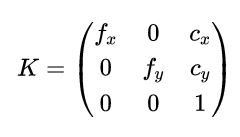

In [ ]:
# Get RGB image and depth path
rgb_file_list = glob.glob(r'./rgb/*')
depth_file_list = glob.glob(r'./depth/*')
rgb_file_list = ["./rgb/step{}.png".format(i+1) for i in range(len(rgb_file_list))]
depth_file_list = ["./depth/step{}.png".format(i+1) for i in range(len(depth_file_list))]

# Calculate fx, fy, cx, cy in intrinsic matrix
intrinsic = np.array([[256, 0., 255],
                      [0., 255, 255],
                      [0., 0., 1]])

# transfer 2D points and depth to 3D coordinate
def depth_image_to_point_cloud(rgb, depth, intrinsic, depth_scale = 1000.0):
    fx, fy = intrinsic[0,0],intrinsic[1,1]
    cx, cy = intrinsic[0,2],intrinsic[1,2]
    h, w = np.mgrid[0:depth.shape[0],0:depth.shape[1]]
    # TODOs depth to point cloud



    X = np.ravel(x)
    Y = np.ravel(y)
    Z = np.ravel(z)
    position = np.vstack((X, Y, Z))
    R = np.ravel(rgb[:, :, 0])/255.
    G = np.ravel(rgb[:, :, 1])/255.
    B = np.ravel(rgb[:, :, 2])/255.
    points = np.transpose(position)    
    colors = np.transpose(np.vstack((R, G, B)))
    return (points, colors)

# transfer points to pointcloud format
def make_point_cloud_list(points,  colors):
    pcd = o3d.geometry.PointCloud()
    pcd.points = o3d.utility.Vector3dVector(points[:, 0:3])
    pcd.colors = o3d.utility.Vector3dVector(colors[:, 0:3])
    return pcd

depth_scale = 1000.0  # parameter setting in simulater
pcd_list = []

for i in range(len(rgb_file_list)):
  rgb = cv2.cvtColor(cv2.imread(rgb_file_list[i], 3), cv2.COLOR_BGR2RGB)
  depth = cv2.imread(depth_file_list[i], -1)
  points, colors = depth_image_to_point_cloud(rgb, depth, intrinsic, depth_scale)
  pcd = make_point_cloud_list(points, colors)
  pcd_list.append(pcd)


## **Point cloud alignment**
Now we have point clouds of each image, then we need to transform and align these point clouds to the same coordinate. 

There are **two steps** to align point clouds:

1. Global registration(RANSAC)
2. ICP algorithm

### **Global registration**

Before using ICP, we first run global registration to execute initialization. This step can help local icp algorithm get better result.

In [ ]:
# @title Define global registration functions
def preprocess_point_cloud(pcd, voxel_size):
    pcd_down = pcd.voxel_down_sample(voxel_size)
    radius_normal = voxel_size * 2
    pcd_down.estimate_normals(
        o3d.geometry.KDTreeSearchParamHybrid(radius=radius_normal, max_nn=30))
    radius_feature = voxel_size * 5
    pcd_fpfh = o3d.pipelines.registration.compute_fpfh_feature(
        pcd_down,
        o3d.geometry.KDTreeSearchParamHybrid(radius=radius_feature, max_nn=100))
    return pcd_down, pcd_fpfh

def prepare_dataset(voxel_size, id, pcd_list):
    source = pcd_list[id+1]
    target = pcd_list[id]
    source_down, source_fpfh = preprocess_point_cloud(source, voxel_size)
    target_down, target_fpfh = preprocess_point_cloud(target, voxel_size)
    return source_down, target_down, source_fpfh, target_fpfh

def execute_global_registration(source_down, target_down, source_fpfh,
                                target_fpfh, voxel_size):
    distance_threshold = voxel_size * 1.25
    result = o3d.pipelines.registration.registration_ransac_based_on_feature_matching(
        source_down, target_down, source_fpfh, target_fpfh, True,
        distance_threshold,
        o3d.pipelines.registration.TransformationEstimationPointToPoint(False),
        3, [
            o3d.pipelines.registration.CorrespondenceCheckerBasedOnEdgeLength(
                0.9),
            o3d.pipelines.registration.CorrespondenceCheckerBasedOnDistance(
                distance_threshold)
        ], o3d.pipelines.registration.RANSACConvergenceCriteria(100000, 0.999))
    return result

### **ICP algorithm**

There are **four steps** in icp algorithm:

1. For each point in the source point cloud, find and match the closest point in the reference point cloud.
2. Calculate the combination of rotation and translation matrix(using SVD) which will best align each source point to its match found in the previous step.
3. Transform the source points using the obtained transformation.
4. Iterate until the error smaller then the tolerance we set. Or, the algorithm will stop at the max iteration number.

In [ ]:
def best_fit_transform(A, B):
    '''
    Calculates the least-squares best-fit transform between corresponding 3D points A->B
    Input:
      A: Nx3 numpy array of corresponding 3D points
      B: Nx3 numpy array of corresponding 3D points
    Returns:
      T: 4x4 homogeneous transformation matrix
      R: 3x3 rotation matrix
      t: 3x1 column vector
    '''
    assert len(A) == len(B)
    # TODOs

    # translate points to their centroids


    # rotation matrix

    # special reflection case


    # translation


    # homogeneous transformation
    T = np.identity(4)
    T[0:3, 0:3] = R
    T[0:3, 3] = t

    return T, R, t

def nearest_neighbor(src, dst):
    '''
    Find the nearest (Euclidean) neighbor in dst for each point in src
    Input:
        src: Nx3 array of points
        dst: Nx3 array of points
    Output:
        distances: Euclidean distances (errors) of the nearest neighbor
        indecies: dst indecies of the nearest neighbor
    '''

    neigh = NearestNeighbors(n_neighbors=1)
    neigh.fit(dst)
    
    distances, indices = neigh.kneighbors(src, return_distance=True)
    valid=distances < np.median(distances)*0.8
    return distances[valid].ravel(), indices[valid].ravel(),valid.ravel()

def icp(A, B, init_pose=None, max_iterations=1000, tolerance=0.00001):
    '''
    The Iterative Closest Point method
    Input:
        A: Nx3 numpy array of source 3D points
        B: Nx3 numpy array of destination 3D point
        init_pose: 4x4 homogeneous transformation
        max_iterations: exit algorithm after max_iterations
        tolerance: convergence criteria
    Output:
        T: final homogeneous transformation
        distances: Euclidean distances (errors) of the nearest neighbor
    '''
    A = np.asarray(A.points)
    B = np.asarray(B.points)
    # make points homogeneous, copy them so as to maintain the originals
    src = np.ones((4,A.shape[0]))
    dst = np.ones((4,B.shape[0]))
    src[0:3,:] = np.copy(A.T)
    dst[0:3,:] = np.copy(B.T)

    # apply the initial pose estimation
    if init_pose is not None:
        src = np.dot(init_pose, src)
    prev_error = 0

    # main part
    for i in range(max_iterations):
        # find the nearest neighbours between the current source and destination points
        distances, indices,valid = nearest_neighbor(src[0:3,:].T, dst[0:3,:].T)
        # compute the transformation between the current source and nearest destination points
        T,_,_ = best_fit_transform(src[0:3,valid].T, dst[0:3,indices].T)
        # update the current source
    # refer to "Introduction to Robotics" Chapter2 P28. Spatial description and transformations
        src = np.dot(T, src)

        # check error
        mean_error = np.sum(distances) / distances.size
        if abs(prev_error-mean_error) < tolerance:
            break
        prev_error = mean_error

    # calculcate final tranformation
    T,_,_ = best_fit_transform(A, src[0:3,:].T)

    return T, distances

In [ ]:
# @title Execute ICP registration
def compute_icp_and_align_point_cloud(pcd_list):
    voxel_size = 0.002
    threshold = 0.002
    T_list = []
    for i in range(len(pcd_list)-1):
        print(f'processing point cloud {i+1} and {i+2}:')
        source_down, target_down, source_fpfh, target_fpfh = prepare_dataset(voxel_size, i, pcd_list)
        result = execute_global_registration(source_down, target_down, source_fpfh, target_fpfh, voxel_size)

        T,dis = icp(source_down, target_down, init_pose = result.transformation)
        T_list.append(T)

    for i in range(1, len(T_list)):
        T_list[i] = np.dot(T_list[i-1], T_list[i])

    for i in range(1, len(pcd_list)):
        pcd_list[i].transform(T_list[i-1])   
    return pcd_list, T_list

# get the result and the transformation matrix
pcd_icp_list, T_list = compute_icp_and_align_point_cloud(pcd_list)

processing point cloud 1 and 2:
processing point cloud 2 and 3:
processing point cloud 3 and 4:
processing point cloud 4 and 5:
processing point cloud 5 and 6:
processing point cloud 6 and 7:
processing point cloud 7 and 8:
processing point cloud 8 and 9:
processing point cloud 9 and 10:


## **Visualization**
Because the visualization in open3d can't work on colab, we use plotly packages to visualize scene instead. 

If you run the code on local, you can use *o3d.visualization.draw_geometries(pcd)* to show the point cloud.

In [ ]:
# @title Visualize with plyplot

# down sample to decrease number of points and combine all point clouds
pcd_comine = pcd_list[0].voxel_down_sample(0.002)
count = 20
for i in range(1, count):
  pcd_list[i] = pcd_list[i].voxel_down_sample(0.002)
  pcd_comine += pcd_list[i]

# visualization
points = np.asarray(pcd_comine.points)
colors = np.asarray(pcd_comine.colors)
fig = go.Figure(
    data=[
        go.Scatter3d(
            x=points[:,0], y=points[:,1], z=points[:,2], 
            mode='markers',
            marker=dict(size=1, color=colors, opacity=0.5)
        )
    ],
    layout=dict(
        scene=dict(
            xaxis=dict(visible=False),
            yaxis=dict(visible=False),
            zaxis=dict(visible=False)
        )
    )
)
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
fig.show()

## **Reference**

1. Global registration toturial in open3d:

   http://www.open3d.org/docs/release/tutorial/pipelines/global_registration.html

2. ICP registration toturial in open3d:
 
   http://www.open3d.org/docs/release/tutorial/pipelines/icp_registration.html
